In [1]:
!pip install scikit-image

Looking in indexes: https://mirror.baidu.com/pypi/simple/
     |████████████████████████████████| 29.2MB 9.3MB/s eta 0:00:01
     |████████████████████████████████| 174kB 32.3MB/s eta 0:00:01
     |████████████████████████████████| 4.4MB 23.8MB/s eta 0:00:01


# Import libs

In [2]:
from __future__ import print_function
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline

import argparse
import os
from PIL import Image
import PIL
import numpy as np
from models import *

import paddle
from models.downsampler import Downsampler

from utils.sr_utils import *
from utils.common_utils import *

# Set up parameters

In [3]:
input_depth = 32

INPUT =     'noise'
pad   =     'reflection'
OPT_OVER =  'net'
KERNEL_TYPE='lanczos2'

LR = 0.01
tv_weight = 0.0

OPTIMIZER = 'adam'

# if factor == 4:
#     num_iter = 2000
#     reg_noise_std = 0.03
# elif factor == 8:
#     num_iter = 4000
#     reg_noise_std = 0.05
# else:
#     assert False, 'We did not experiment with other factors'

factor = 8
num_iter = 4000
reg_noise_std = 0.05

imsize = -1
enforse_div32 = 'CROP' # we usually need the dimensions to be divisible by a power of two (32 in this case)
PLOT = True

NET_TYPE = 'skip'
mse = nn.MSELoss()

# Load data and optimize

In [4]:
file_names = ["baboon", "barbara", "bridge", "coastguard", "comic", "face", "flowers", "foreman", "lenna", "man", "monarch", "pepper", "ppt3", "zebra"]
data_dir = 'datas/sr/Set14/'

psnr_DIP = []
psnr_all = []

HR and LR resolutions: (480, 480), (60, 60)


/opt/conda/envs/python35-paddle120-env/lib/python3.7/site-packages/paddle/nn/layer/norm.py:641: UserWarning: When training, we now always track global mean and variance.
  "When training, we now always track global mean and variance.")
/opt/conda/envs/python35-paddle120-env/lib/python3.7/site-packages/matplotlib/cbook/__init__.py:2349: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated, and in 3.8 it will stop working
  if isinstance(obj, collections.Iterator):
/opt/conda/envs/python35-paddle120-env/lib/python3.7/site-packages/matplotlib/cbook/__init__.py:2366: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated, and in 3.8 it will stop working
  return list(data) if isinstance(data, collections.MappingView) else data


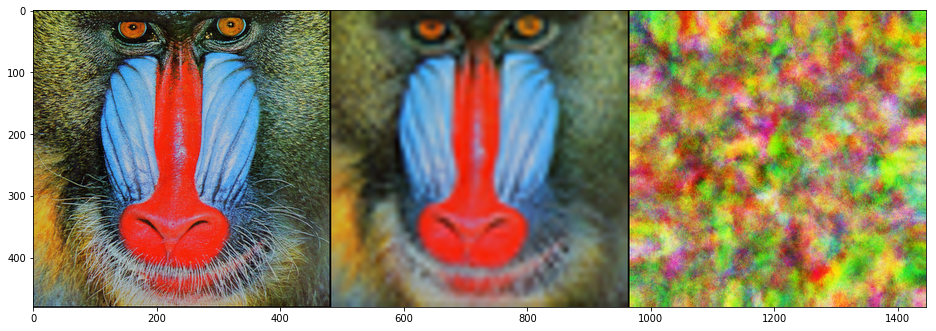

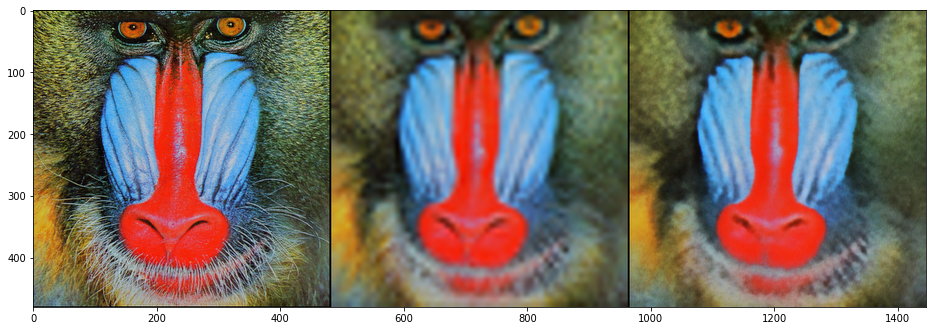

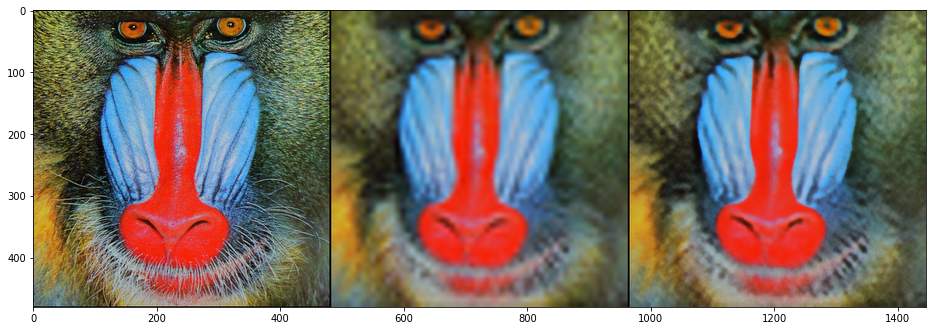

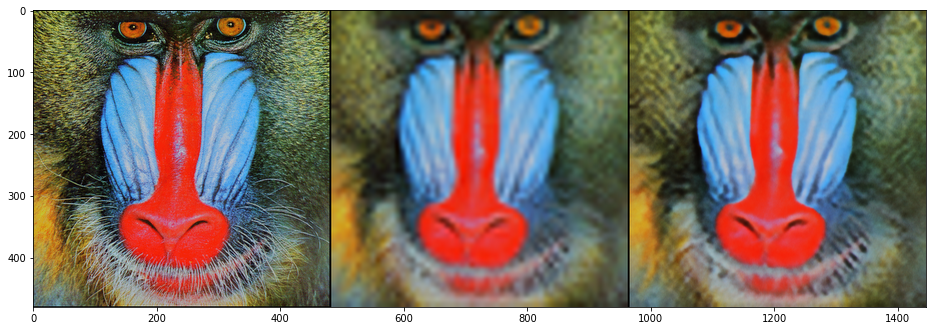

baboon: PSNR_HR = 21.438
HR and LR resolutions: (704, 576), (88, 72)


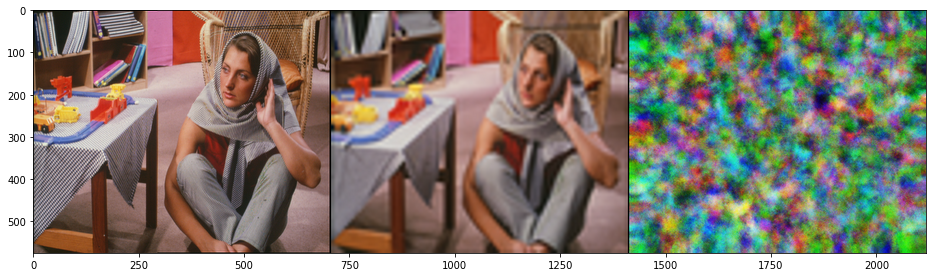

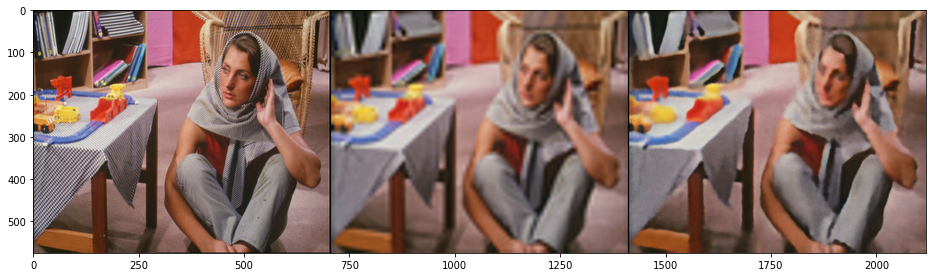

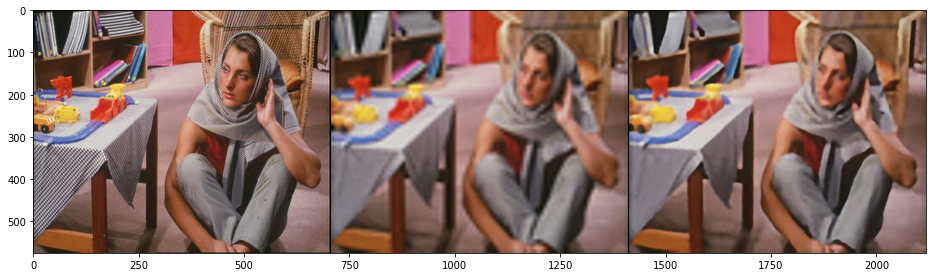

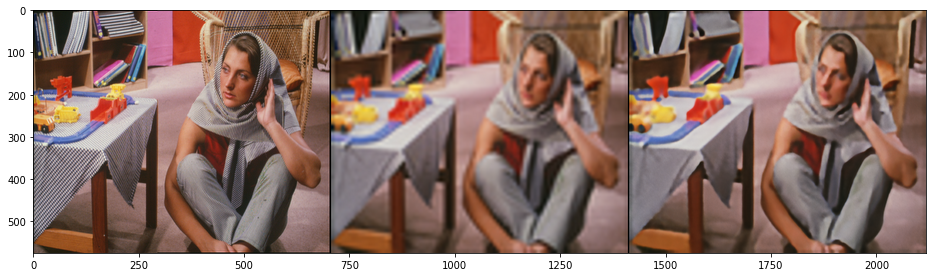

barbara: PSNR_HR = 24.075
HR and LR resolutions: (512, 512), (64, 64)


/opt/conda/envs/python35-paddle120-env/lib/python3.7/site-packages/matplotlib/image.py:425: DeprecationWarning: np.asscalar(a) is deprecated since NumPy v1.16, use a.item() instead
  a_min = np.asscalar(a_min.astype(scaled_dtype))
/opt/conda/envs/python35-paddle120-env/lib/python3.7/site-packages/matplotlib/image.py:426: DeprecationWarning: np.asscalar(a) is deprecated since NumPy v1.16, use a.item() instead
  a_max = np.asscalar(a_max.astype(scaled_dtype))


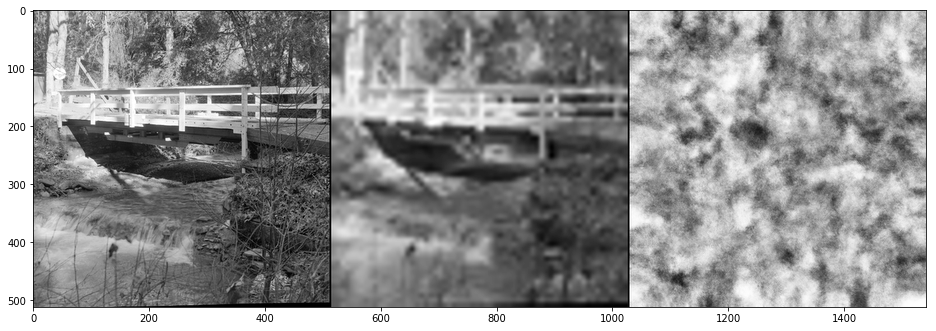

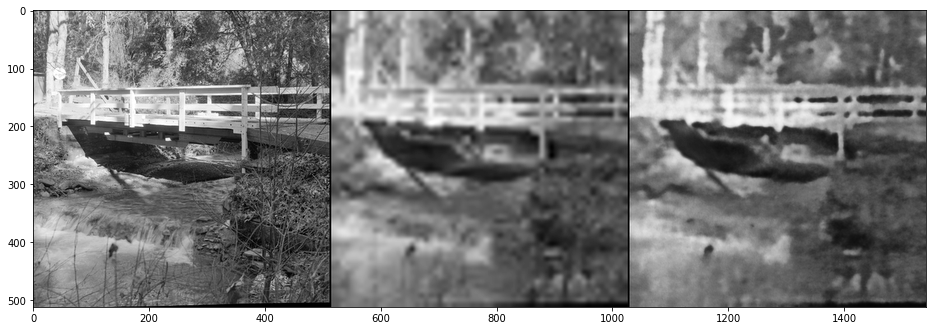

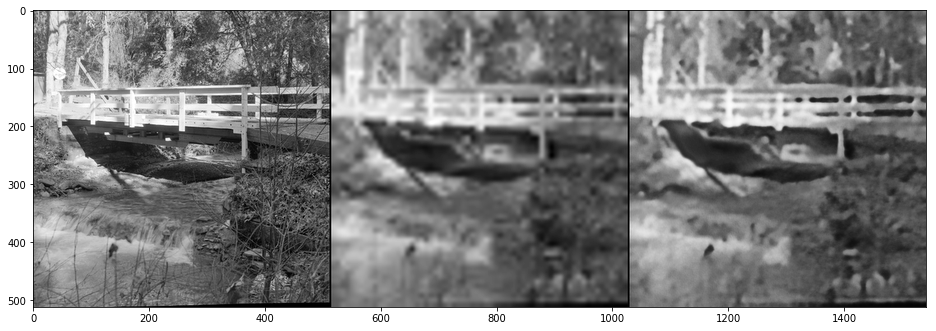

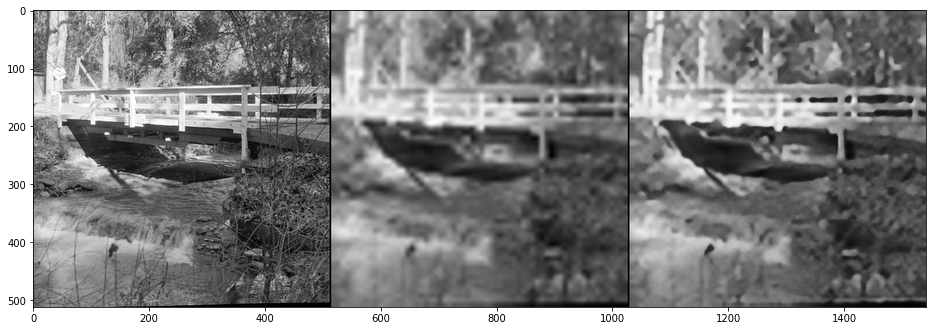

bridge: PSNR_HR = 21.126
HR and LR resolutions: (352, 288), (44, 36)


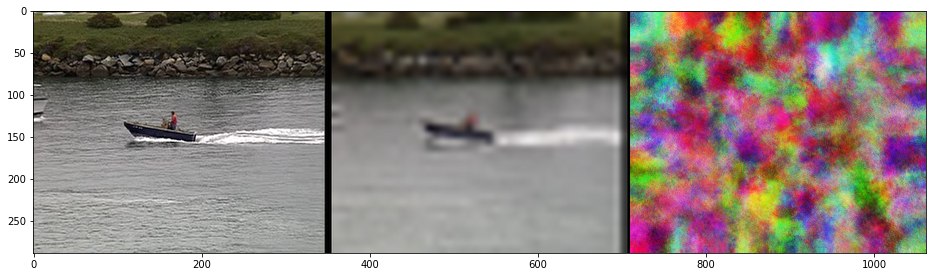

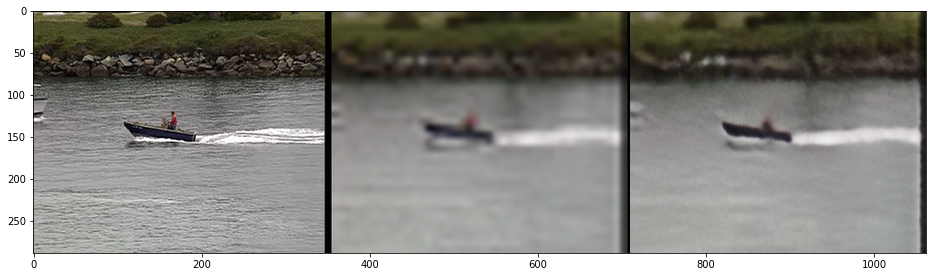

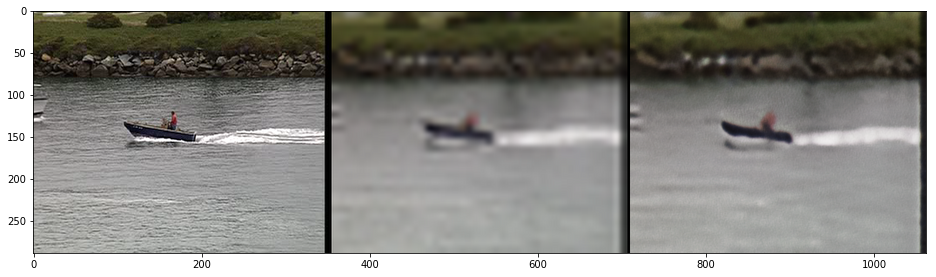

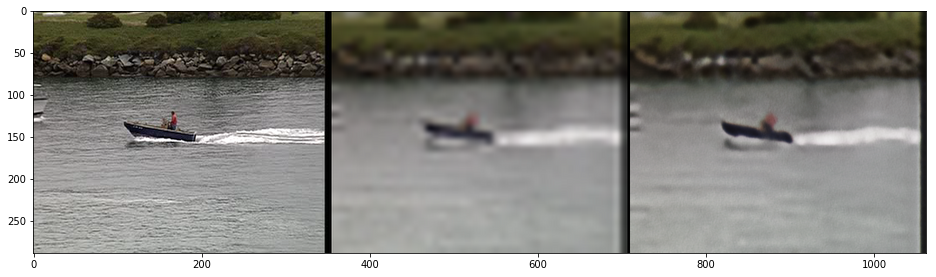

coastguard: PSNR_HR = 24.059
HR and LR resolutions: (224, 352), (28, 44)


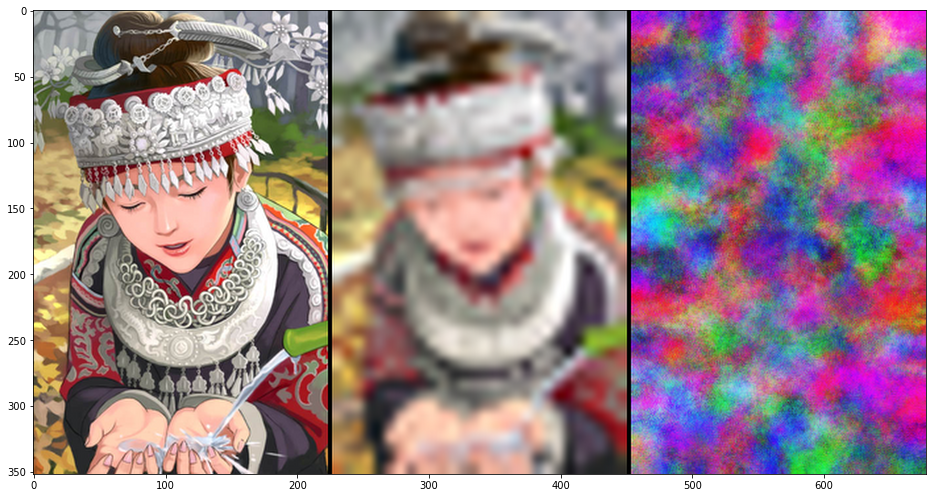

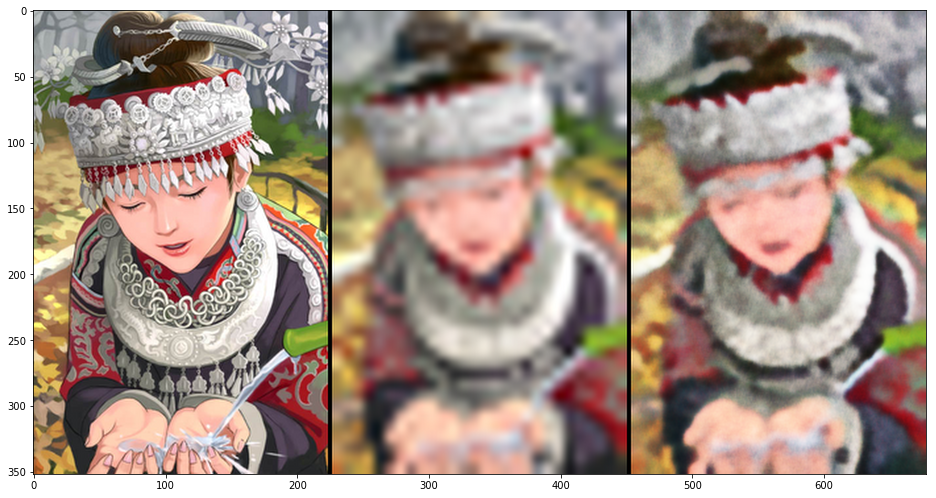

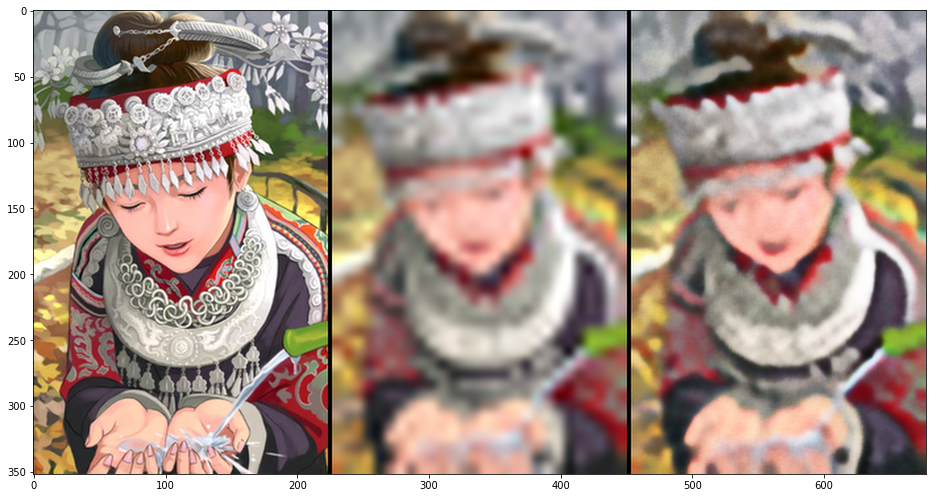

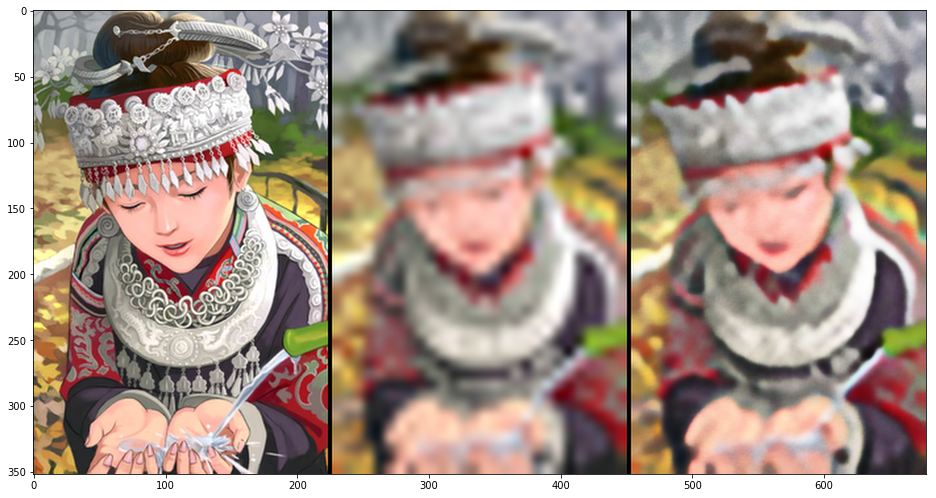

comic: PSNR_HR = 19.980
HR and LR resolutions: (256, 256), (32, 32)


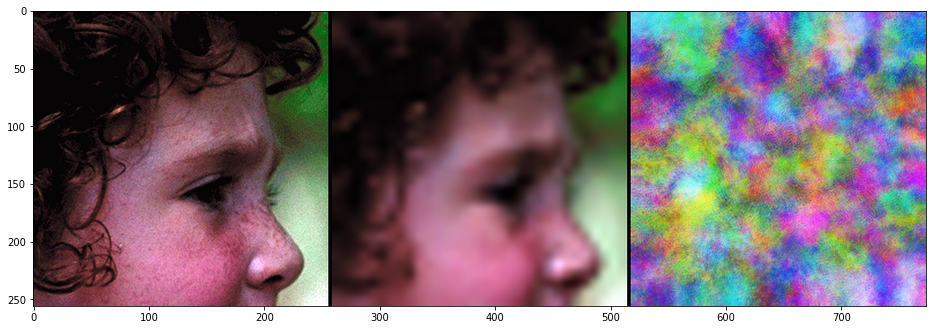

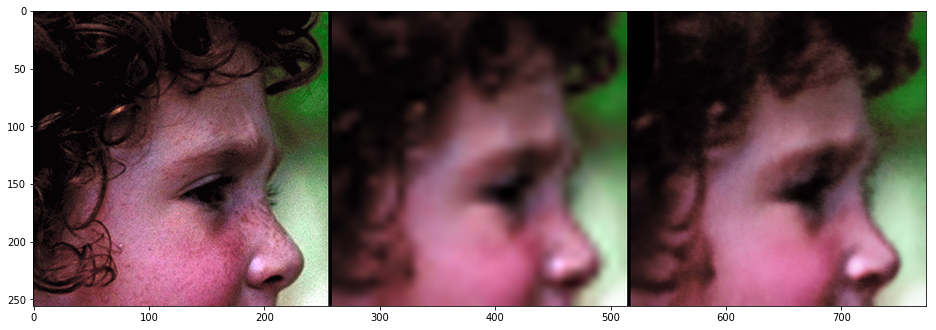

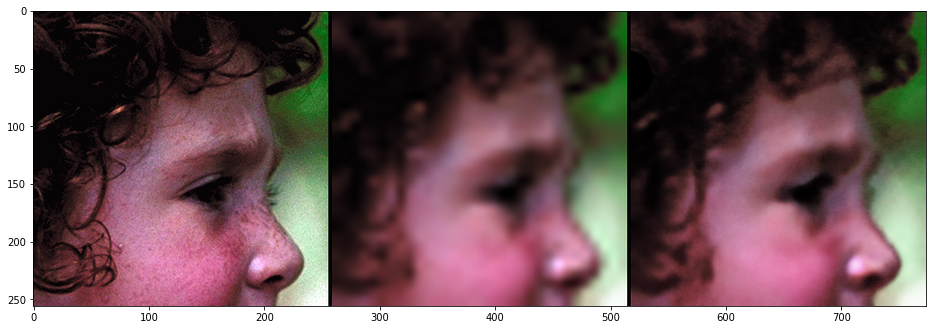

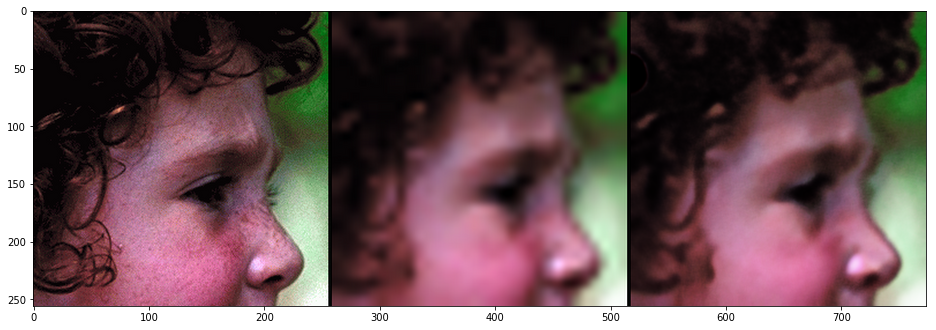

face: PSNR_HR = 29.602
HR and LR resolutions: (480, 352), (60, 44)


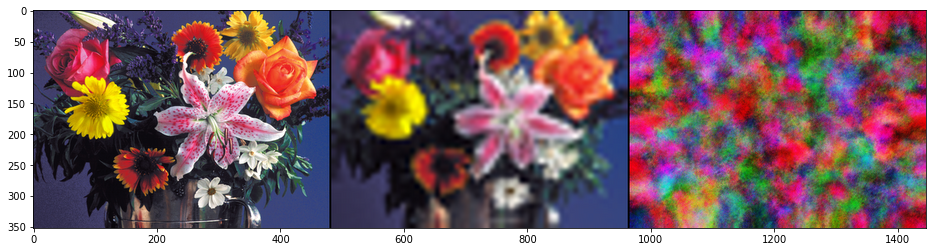

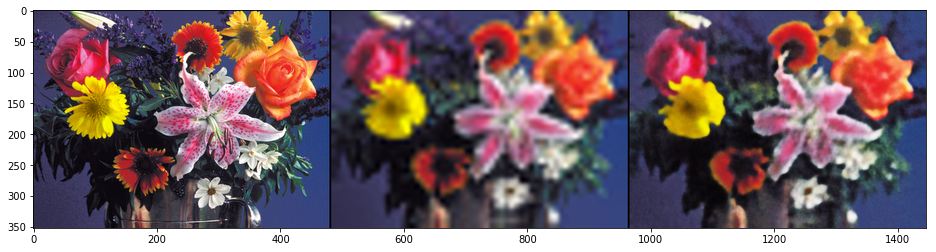

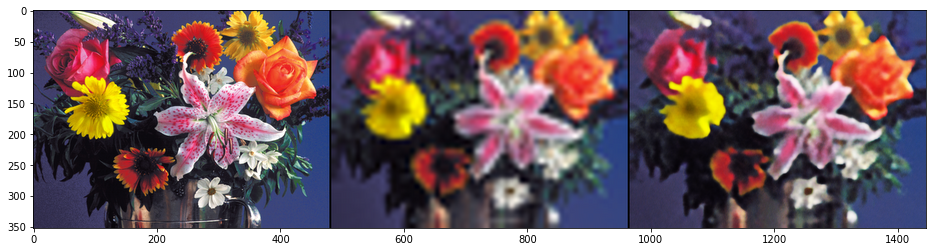

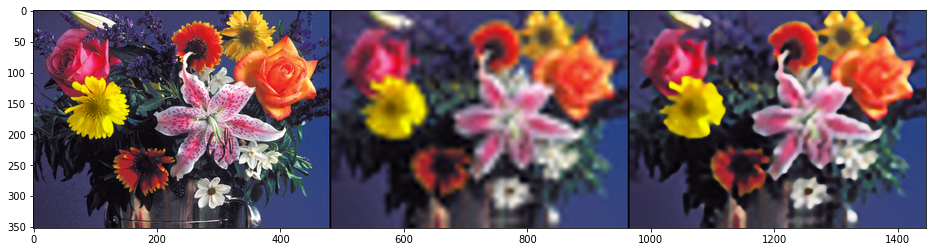

flowers: PSNR_HR = 23.079
HR and LR resolutions: (352, 288), (44, 36)


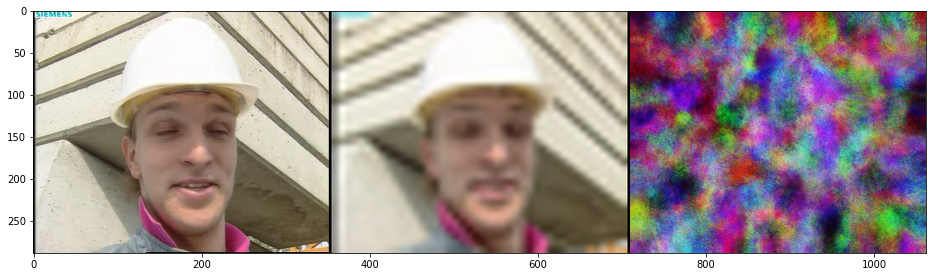

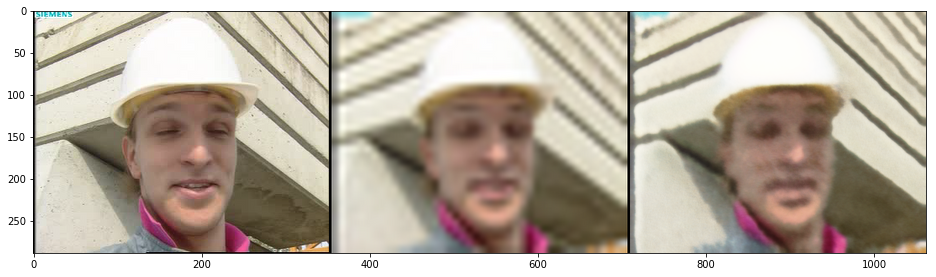

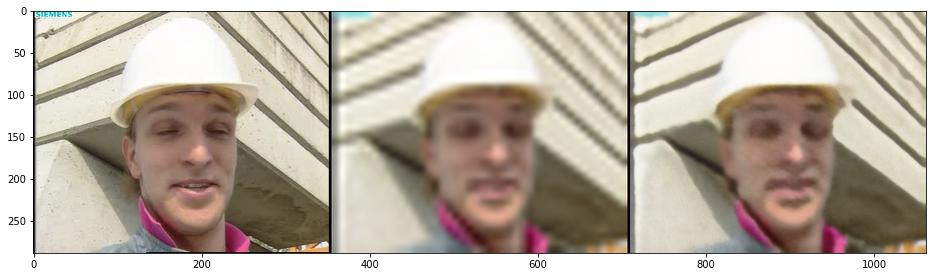

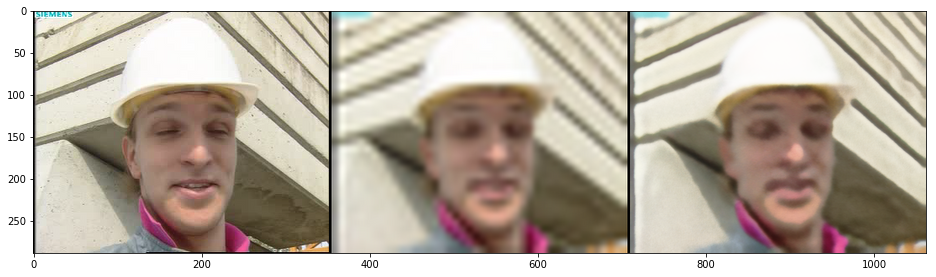

foreman: PSNR_HR = 27.710
HR and LR resolutions: (512, 512), (64, 64)


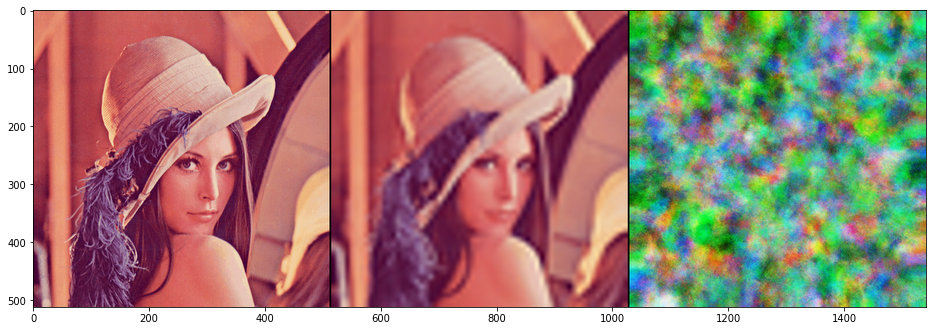

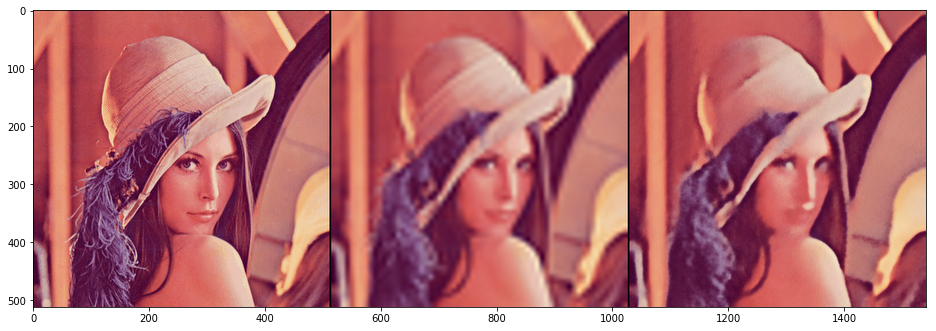

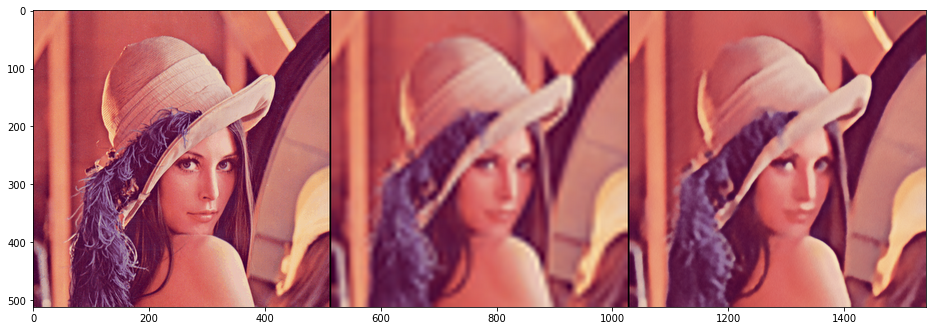

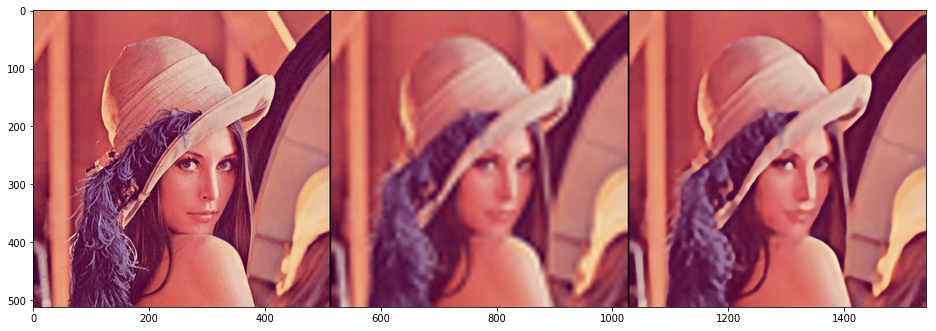

lenna: PSNR_HR = 27.890
HR and LR resolutions: (512, 512), (64, 64)


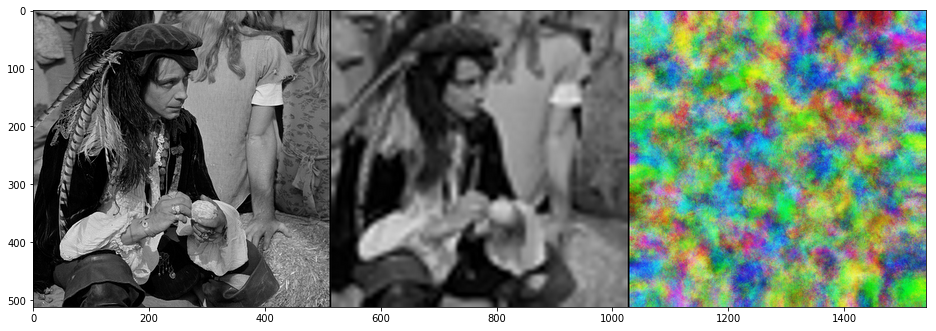

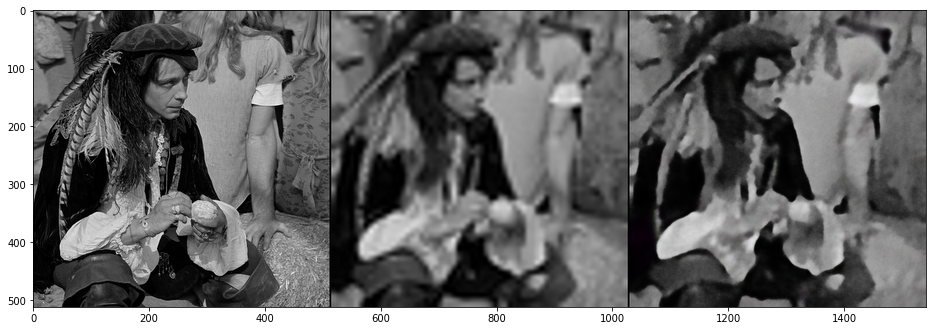

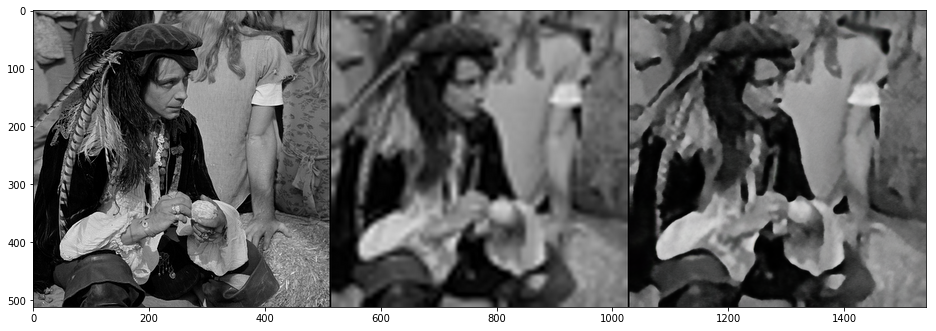

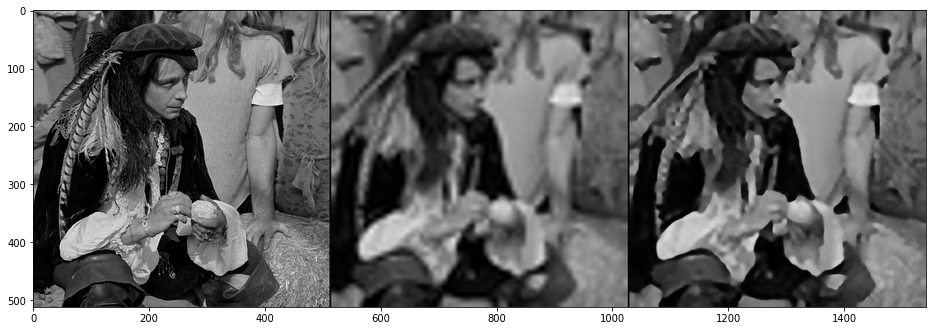

man: PSNR_HR = 23.811
HR and LR resolutions: (768, 512), (96, 64)


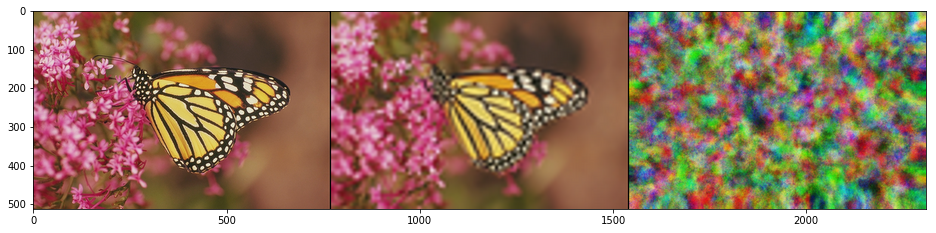

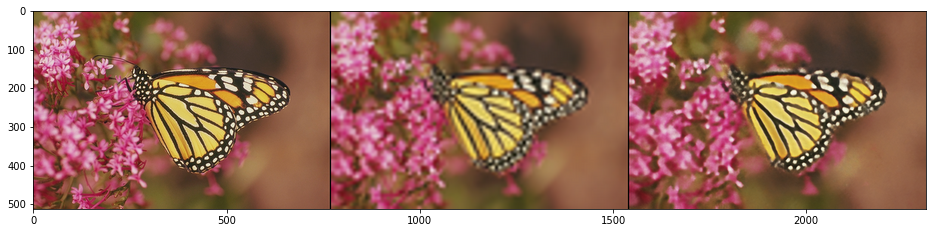

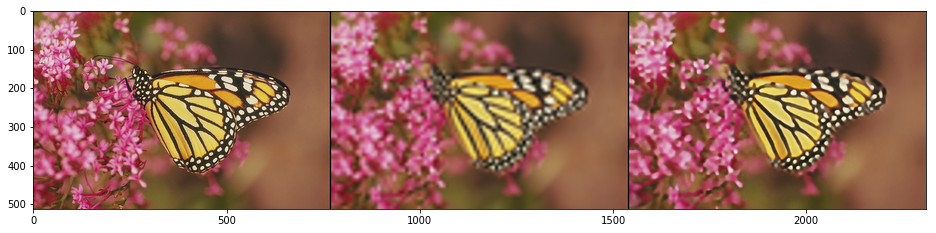

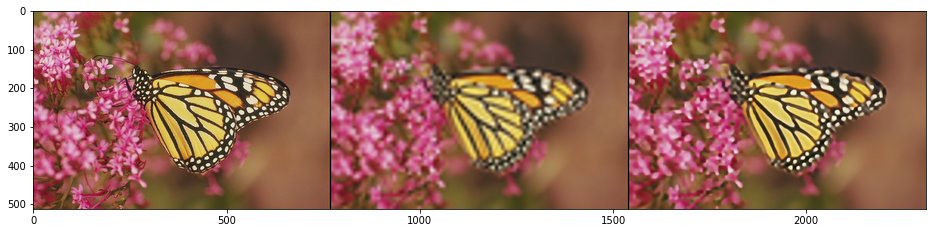

monarch: PSNR_HR = 25.182
HR and LR resolutions: (512, 512), (64, 64)


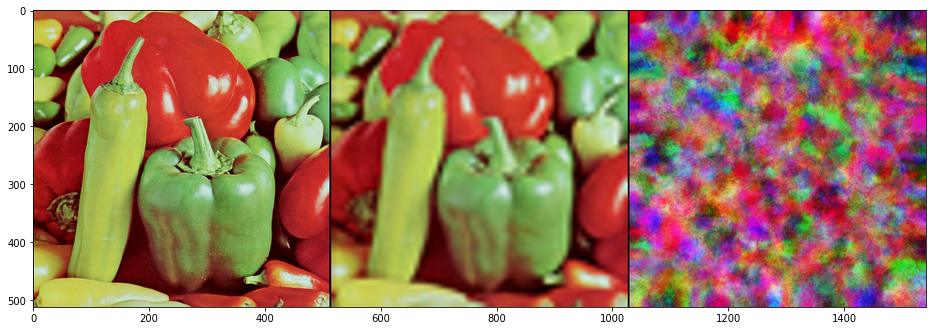

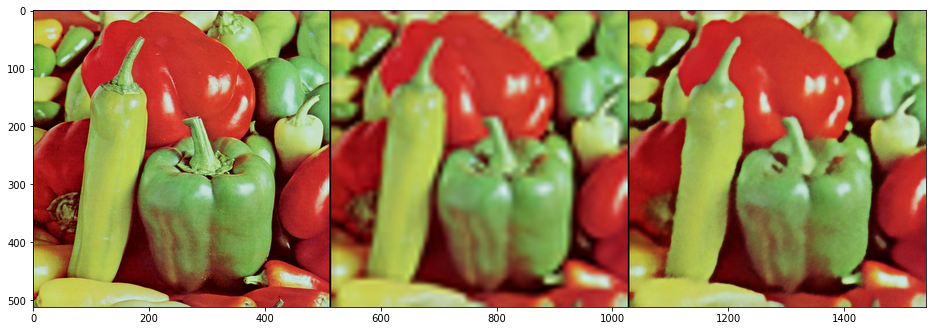

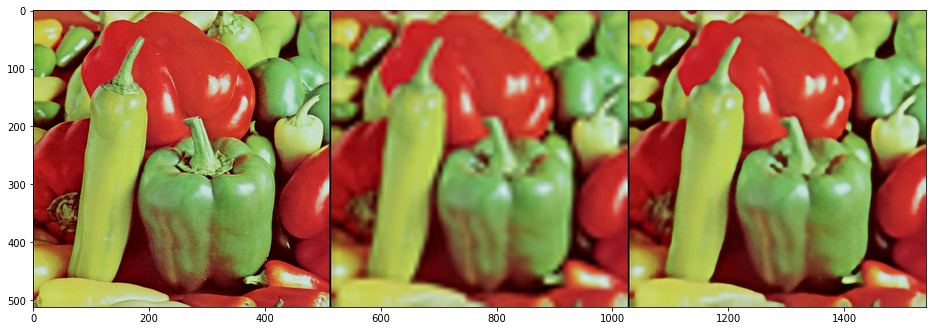

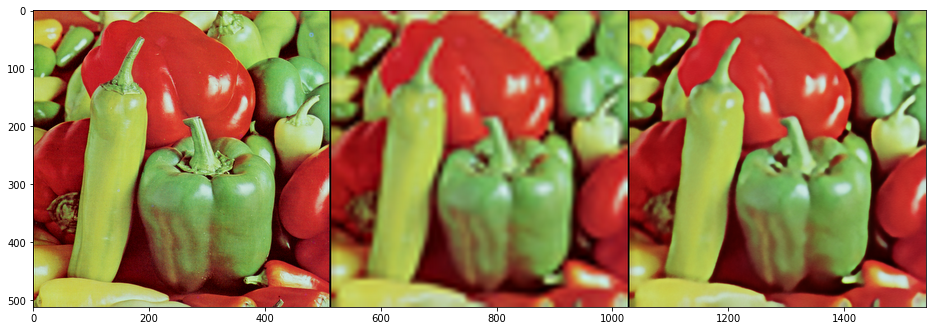

pepper: PSNR_HR = 29.145
HR and LR resolutions: (512, 640), (64, 80)


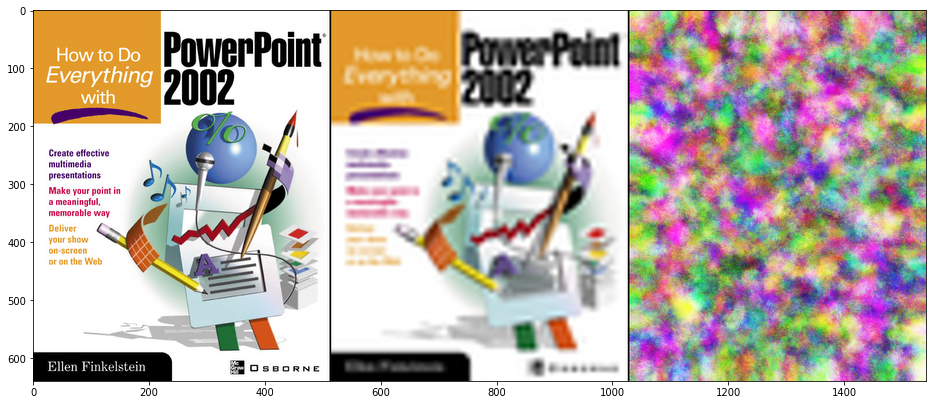

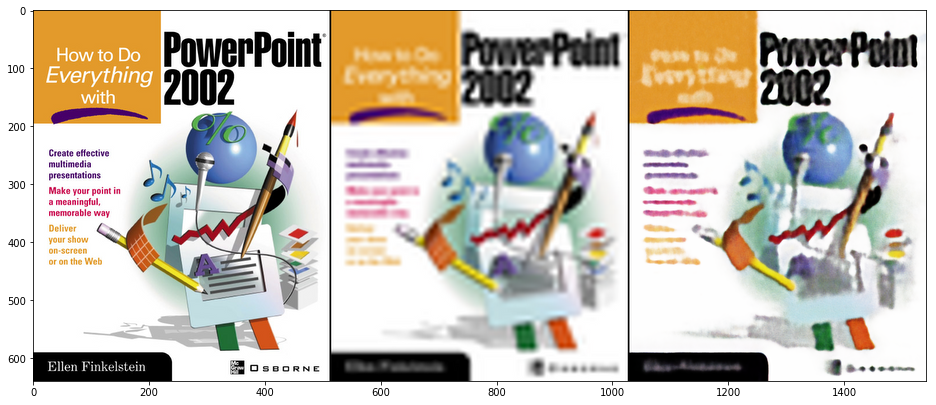

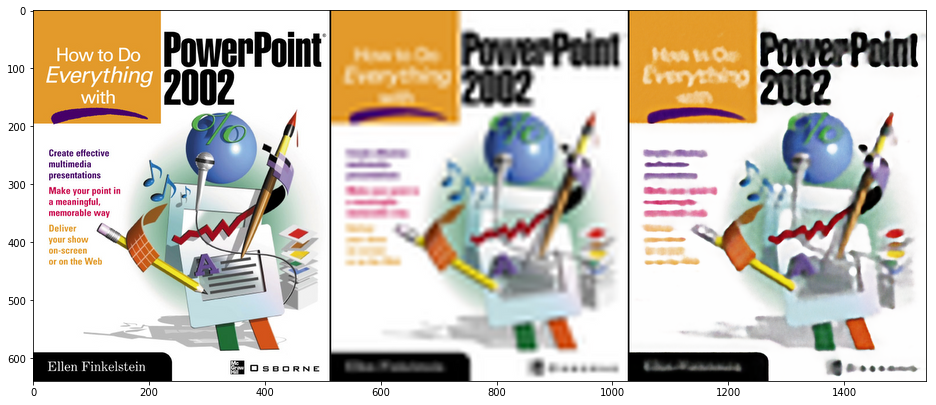

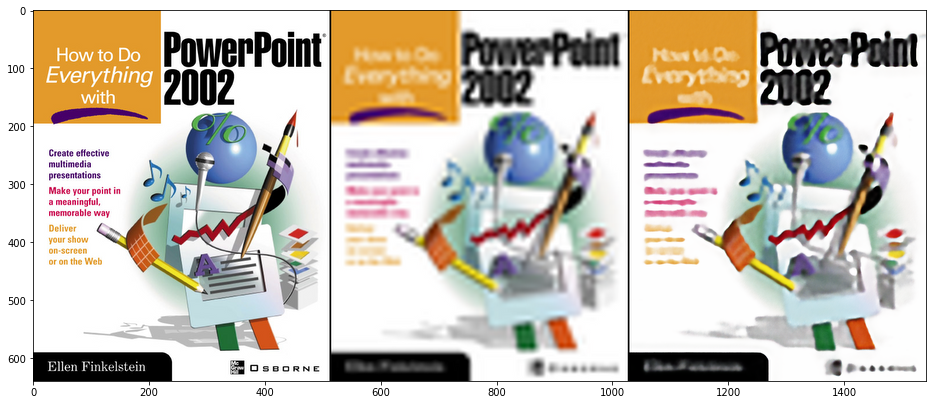

ppt3: PSNR_HR = 20.297
HR and LR resolutions: (576, 384), (72, 48)


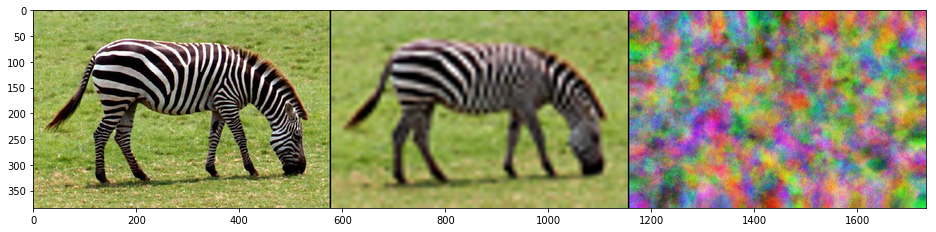

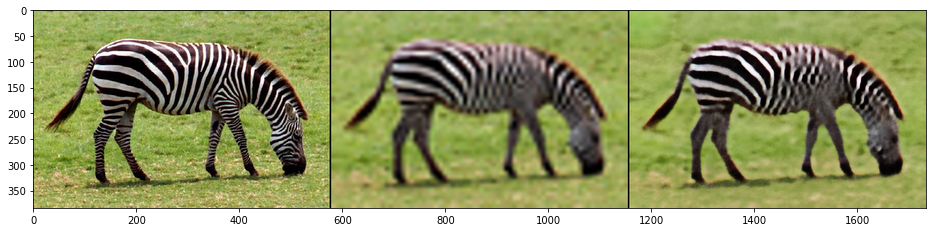

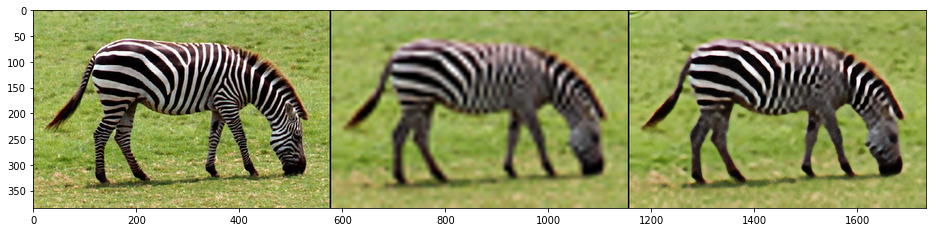

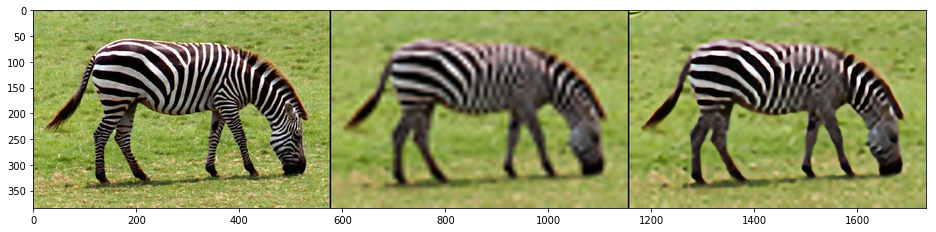

zebra: PSNR_HR = 20.921


In [5]:
for name in file_names:
    # Load Data
    path = data_dir + name
    img = load_LR_HR_imgs_sr(path + '_GT.png', imsize, factor, enforse_div32)
    img['bicubic_np'], img['sharp_np'], img['nearest_np'] = get_baselines(img['LR_pil'], img['HR_pil'])

    img_LR_var = paddle.to_tensor(img['LR_np']).unsqueeze(0)
    n_channels = img['LR_np'].shape[0]

    # Get Net and Input
    net = get_net(input_depth, NET_TYPE, pad,
                  n_channels=n_channels,
                  skip_n33d=128,
                  skip_n33u=128,
                  skip_n11=4,
                  num_scales=5,
                  upsample_mode='bilinear')
    downsampler = Downsampler(n_planes=n_channels, factor=factor, kernel_type=KERNEL_TYPE, phase=0.5, preserve_size=True)
    net_input_z = get_noise(input_depth, INPUT, (img['HR_pil'].size[1], img['HR_pil'].size[0]))

    optimizer = paddle.optimizer.Adam(learning_rate=LR, parameters=net.parameters())

    psnr_history = []
    for i in range(num_iter):

        if reg_noise_std > 0:
            net_input = net_input_z + (paddle.normal(shape=net_input_z.shape) * reg_noise_std)
        else:
            net_input = net_input_z

        out_HR = net(net_input)
        out_LR = downsampler(out_HR)

        total_loss = mse(out_LR, img_LR_var)

        if tv_weight > 0:
            total_loss += tv_weight * tv_loss(out_HR)

        total_loss.backward()
        optimizer.step()
        optimizer.clear_grad()

        # Log
        psnr_LR = compare_PSNR(np.clip(out_LR.squeeze(0).numpy(), 0, 1), img['LR_np'])
        psnr_HR = compare_PSNR(np.clip(out_HR.squeeze(0).numpy(), 0, 1), img['HR_np'])
        # print ('Iteration %05d    PSNR_LR %.3f   PSNR_HR %.3f' % (i, psnr_LR, psnr_HR), '\r', end='')

        # History
        psnr_history.append([psnr_LR, psnr_HR])

        if PLOT and i % 1000 == 0:
            out_HR_np = out_HR.squeeze().numpy()
            plot_image_grid([img['HR_np'], img['bicubic_np'], np.clip(out_HR.squeeze(0).numpy(), 0, 1)], factor=13, nrows=3)

    # Results
    psnr_all.append(psnr_history)

    out_DIP = np.clip(net(net_input_z).squeeze(0).numpy(), 0, 1)
    psnr_out = compare_PSNR(out_DIP, img['HR_np'])
    print(name + ': PSNR_HR = %.3f' % (psnr_out))

    psnr_DIP.append(psnr_out)
    if n_channels==3:
        matplotlib.image.imsave(path + '_DIP.png', out_DIP.transpose(1,2,0))
    else:
        matplotlib.image.imsave(path + '_DIP.png', out_DIP.squeeze(), cmap = matplotlib.cm.gray)



In [6]:
psnr_avg = np.mean(psnr_DIP)

In [7]:
psnr_avg

24.16529286849991